In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
from sklearn.model_selection import train_test_split

In [2]:
from shap.datasets import adult
X, y_true = adult(display=False)

#X = (X.apply(lambda x: pd.factorize(x)[0]))



In [3]:
#sample the data for demo speed
X = X.head(5000)
y_true = pd.DataFrame(y_true).head(5000)

In [4]:
y_true = y_true * 1 #convert y to bianry numeric
y_true = y_true.astype('int')
pd.DataFrame(y_true).head(10)

,0
0,0
1,0
2,0
3,0
4,0
5,0
6,0
7,1
8,1
9,1


In [5]:
#Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y_true, test_size=0.3, random_state=1) # 70% training and 30% test

In [6]:
X_train.head()

,Age,Workclass,Education-Num,Marital Status,Occupation,Relationship,Race,Sex,Capital Gain,Capital Loss,Hours per week,Country
1334,51.0,4,11.0,2,10,4,4,1,0.0,0.0,40.0,39
4768,40.0,1,14.0,2,13,4,1,1,0.0,1902.0,40.0,30
65,36.0,4,9.0,2,3,4,4,1,0.0,0.0,40.0,39
177,34.0,4,9.0,4,6,0,2,1,0.0,0.0,40.0,39
4489,28.0,4,12.0,5,8,0,4,1,0.0,0.0,40.0,39


In [7]:
y_train.head()

,0
1334,1
4768,1
65,0
177,0
4489,0


# Glassbox interpretation

In [8]:
#Update interpret
#! pip install interpret 

In [9]:
#! pip uninstall interpret-community --yes

In [10]:
#! pip uninstall interpret  --yes

In [11]:
#! pip install azureml-interpret #==1.20.0

In [12]:
from interpret.glassbox import ExplainableBoostingClassifier

ebm = ExplainableBoostingClassifier()
ebm.fit(X_train, y_train)

ExplainableBoostingClassifier(binning='quantile', early_stopping_rounds=50,
                              early_stopping_tolerance=0,
                              feature_names=['Age', 'Workclass',
                                             'Education-Num', 'Marital Status',
                                             'Occupation', 'Relationship',
                                             'Race', 'Sex', 'Capital Gain',
                                             'Capital Loss', 'Hours per week',
                                             'Country'],
                              feature_types=['continuous', 'continuous',
                                             'continuous', 'continuous',
                                             'continuous', 'continuous',
                                             'continuous', 'categorical',
                                             'continuous', 'continuous',
                                             'continuous', 'continuo

In [13]:
#! pip install  plotly

In [14]:
ebm_global = ebm.explain_global()

In [15]:
pd.DataFrame(ebm_global.data())

,type,names,scores
0,univariate,Age,0.643521
1,univariate,Workclass,0.125570
2,univariate,Education-Num,0.488803
3,univariate,Marital Status,0.734782
4,univariate,Occupation,0.357440
5,univariate,Relationship,0.401250
6,univariate,Race,0.105258
7,univariate,Sex,0.195677
8,univariate,Capital Gain,0.466104
9,univariate,Capital Loss,0.122018


In [16]:
from interpret import show

ebm_global.visualize()

In [17]:
from interpret import show
show(ebm_global)
#Cloud environment detected (['azureml', 'ipython-zmq', 'ipython']): viz integration is still experimental.

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/interpret/provider/visualize.py:44: UserWarning:

Cloud environment detected (['azureml', 'ipython-zmq', 'ipython']): viz integration is still experimental.



In [18]:
ebm_local = ebm.explain_local(X_test, y_test, "local")


In [19]:
ebm_local.visualize()

In [20]:
ebm_local
show(ebm_local)

In [21]:
#! pip install dash_cytoscape

In [22]:
#from interpret.glassbox import ClassificationTree
#import dash_cytoscape as cyto

#dt = ClassificationTree()
#dt.fit(X_train, y_train)

#from interpret import show

#dt_global = dt.explain_global()
#show(dt_global)

# Blackbox - create a DecisionTree model

In [23]:
#Train a tree
#from sklearn.neural_network import MLPClassifier
#classifier = MLPClassifier()
#from sklearn.naive_bayes import GaussianNB
#classifier = GaussianNB()
#from sklearn.ensemble import RandomForestClassifier

classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)

#Run the predictions
y_pred = classifier.predict(X_test)

#See the accuracy
metrics.accuracy_score(y_test, y_pred)

0.808

[[995 154]
 [134 217]]


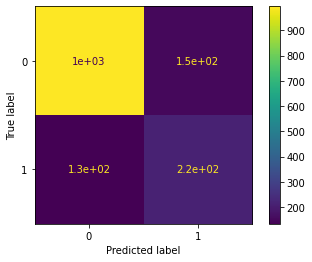

In [24]:
from sklearn.metrics import confusion_matrix, plot_confusion_matrix
print(confusion_matrix(y_test, y_pred))
plot_confusion_matrix(classifier, X_test, y_test)

In [25]:
#Name the classes
classes = ['Loan', 'NoLoan']

In [26]:
%%time
from interpret.ext.blackbox import TabularExplainer

# "features" and "classes" fields are optional
explainer = TabularExplainer(classifier, 
                             X_train, 
                             classes=classes)

Could not import LIME, required for LIMEExplainer
CPU times: user 630 ms, sys: 83.2 ms, total: 714 ms
Wall time: 6.28 s


/anaconda/envs/azureml_py36/lib/python3.6/site-packages/shap/explainers/tree.py:104: UserWarning:

Setting feature_perturbation = "tree_path_dependent" because no background data was given.



In [27]:
%%time
#Run the explainer
#import warnings
#We get a lot of warning so filter them out for this
#warnings.filterwarnings('ignore')

global_explanation = explainer.explain_global(X_train)

CPU times: user 1.21 s, sys: 3.1 ms, total: 1.21 s
Wall time: 2.43 s


In [28]:
#Get the global feature importance
global_explanation.get_feature_importance_dict()

{'Relationship': 0.1591763463421671,
 'Education-Num': 0.08536570243301846,
 'Age': 0.07448180138676994,
 'Capital Gain': 0.05550813550327975,
 'Occupation': 0.05279883788096225,
 'Hours per week': 0.04347832926152965,
 'Workclass': 0.01850241104583081,
 'Capital Loss': 0.014576369098486548,
 'Race': 0.009783977042264448,
 'Sex': 0.009490696063976657,
 'Country': 0.008283355012635385,
 'Marital Status': 0.007308415489747587}

In [29]:
import pandas as pd
pd.DataFrame(global_explanation.get_ranked_global_values(), global_explanation.get_ranked_global_names())


,0
Relationship,0.159176
Education-Num,0.085366
Age,0.074482
Capital Gain,0.055508
Occupation,0.052799
Hours per week,0.043478
Workclass,0.018502
Capital Loss,0.014576
Race,0.009784
Sex,0.009491


In [30]:
X_train

,Age,Workclass,Education-Num,Marital Status,Occupation,Relationship,Race,Sex,Capital Gain,Capital Loss,Hours per week,Country
1334,51.0,4,11.0,2,10,4,4,1,0.0,0.0,40.0,39
4768,40.0,1,14.0,2,13,4,1,1,0.0,1902.0,40.0,30
65,36.0,4,9.0,2,3,4,4,1,0.0,0.0,40.0,39
177,34.0,4,9.0,4,6,0,2,1,0.0,0.0,40.0,39
4489,28.0,4,12.0,5,8,0,4,1,0.0,0.0,40.0,39
...,...,...,...,...,...,...,...,...,...,...,...,...
2895,45.0,4,10.0,5,1,1,4,0,0.0,0.0,27.0,39
2763,24.0,1,9.0,4,1,0,4,0,0.0,0.0,40.0,39
905,46.0,4,9.0,0,7,0,4,0,0.0,0.0,38.0,39
3980,55.0,0,12.0,2,0,4,2,1,0.0,0.0,20.0,39


In [31]:
#Xvalues, y_values = adult(display=True)
#X_trainWithValues = Xvalues.iloc[X_train.index]

In [32]:
##Warning - Additional setup needed to run in Jupyter labs
from interpret_community.widget import ExplanationDashboard

ExplanationDashboard(global_explanation, classifier, datasetX=X_train, true_y=y_train)

## Look in more detail at an Individual record

In [33]:
#PFIExplainer with a neural network
#PFIExplainer can only do global explinations - not local

from sklearn.neural_network import MLPClassifier
classifier = MLPClassifier()

classifier.fit(X_train, y_train)

#Run the predictions
y_pred = classifier.predict(X_test)

#See the accuracy
print(metrics.accuracy_score(y_test, y_pred))


from interpret.ext.blackbox import PFIExplainer

# "features" and "classes" fields are optional
explainer = PFIExplainer(classifier,
                         features=X_train.columns, 
                         classes=classes)

global_explanation = explainer.explain_global(X_train, y_train)

global_explanation.get_feature_importance_dict()

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:934: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

5it [00:00, 45.10it/s]

0.8086666666666666


12it [00:00, 43.09it/s]


{'Capital Gain': 0.0537142857142856,
 'Education-Num': 0.03571428571428559,
 'Relationship': 0.03399999999999981,
 'Age': 0.017142857142857015,
 'Marital Status': 0.016571428571428348,
 'Hours per week': 0.006857142857142784,
 'Occupation': 0.0034285714285713365,
 'Capital Loss': 0.003142857142857114,
 'Country': 0.0011428571428571122,
 'Workclass': -0.00028571428571433355,
 'Race': -0.002571428571428669,
 'Sex': -0.0028571428571430024}

In [34]:
#Mimic Explainer with a neural network
from interpret.ext.glassbox import DecisionTreeExplainableModel
from sklearn.neural_network import MLPClassifier
classifier = MLPClassifier()

classifier.fit(X_train, y_train)

#Run the predictions
y_pred = classifier.predict(X_test)

#See the accuracy
print(metrics.accuracy_score(y_test, y_pred))


from interpret.ext.blackbox import MimicExplainer

# "features" and "classes" fields are optional
explainer = MimicExplainer(model = classifier,
                         initialization_examples=X_test,
                         explainable_model=DecisionTreeExplainableModel,
                         classes=classes)

global_explanation = explainer.explain_global(X_train)

global_explanation.get_feature_importance_dict()

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:934: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/interpret_community/mimic/model_distill.py:19: RuntimeWarning:

divide by zero encountered in true_divide

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/shap/explainers/tree.py:104: UserWarning:

Setting feature_perturbation = "tree_path_dependent" because no background data was given.



0.802


{'Relationship': 1.081737140964414,
 'Capital Gain': 0.9292593260443126,
 'Capital Loss': 0.6630485907827488,
 'Age': 0.5182110370844448,
 'Education-Num': 0.4941509215342498,
 'Hours per week': 0.25062960285475555,
 'Country': 0.08112587911261296,
 'Occupation': 0.079085953833098,
 'Marital Status': 0.05219838600333342,
 'Workclass': 0.026162026433263433,
 'Sex': 0.013077052822313587,
 'Race': 0.009314292106783565}

In [35]:
##Tabuar Explainer with a neural network takes a bit longer
#from interpret.ext.glassbox import DecisionTreeExplainableModel
#from sklearn.neural_network import MLPClassifier
#classifier = MLPClassifier()
#
#classifier.fit(X_train, y_train)
#
##Run the predictions
#y_pred = classifier.predict(X_test)
#
##See the accuracy
#print(metrics.accuracy_score(y_test, y_pred))
#
#from interpret.ext.blackbox import TabularExplainer
#
## "features" and "classes" fields are optional
#explainer = TabularExplainer(classifier, 
#                             X_train, 
#                             classes=classes)
#
#global_explanation = explainer.explain_global(X_train)
#
#global_explanation.get_feature_importance_dict()

In [36]:
##Warning - Additional setup needed to run in Jupyter labs
from interpret_community.widget import ExplanationDashboard

ExplanationDashboard(global_explanation, classifier, datasetX=X_train, true_y=y_train)

In [37]:
X_test[1:2]

,Age,Workclass,Education-Num,Marital Status,Occupation,Relationship,Race,Sex,Capital Gain,Capital Loss,Hours per week,Country
4767,21.0,4,10.0,4,10,3,4,0,0.0,0.0,10.0,39


In [38]:
# get explanation for the first data point in the test set
local_explanation = explainer.explain_local(X_test[1:2])

In [39]:
X_test[1:2]

,Age,Workclass,Education-Num,Marital Status,Occupation,Relationship,Race,Sex,Capital Gain,Capital Loss,Hours per week,Country
4767,21.0,4,10.0,4,10,3,4,0,0.0,0.0,10.0,39


In [40]:
# sorted feature importance values and feature names
sorted_local_importance_names = local_explanation.get_ranked_local_names()
sorted_local_importance_values = local_explanation.get_ranked_local_values()

In [41]:
print(sorted_local_importance_names)
#print(sorted_local_importance_values)

[[['Age', 'Capital Gain', 'Capital Loss', 'Hours per week', 'Relationship', 'Education-Num', 'Country', 'Workclass', 'Race', 'Marital Status', 'Sex', 'Occupation']], [['Occupation', 'Sex', 'Marital Status', 'Race', 'Workclass', 'Country', 'Education-Num', 'Relationship', 'Hours per week', 'Capital Loss', 'Capital Gain', 'Age']]]


In [42]:
local_explanation.get_local_importance_rank()

[[[0, 8, 9, 10, 5, 2, 11, 1, 6, 3, 7, 4]],
 [[4, 7, 3, 6, 1, 11, 2, 5, 10, 9, 8, 0]]]

In [43]:
#!pip install plotly

In [44]:
global_explanation.visualize(2)

## Identify rows that are influenced mainly by gender 

In [45]:
# get explanation for the first data point in the test set
local_explanation = explainer.explain_local(X_test)

In [46]:
# sorted feature importance values and feature names
sorted_local_importance_names = local_explanation.get_ranked_local_names()
sorted_local_importance_values = local_explanation.get_ranked_local_values()

dfslin = pd.DataFrame(sorted_local_importance_names[1])
dfsliv = pd.DataFrame(sorted_local_importance_values[1])

dfslin["FirstColumnImportanceValue"] = dfsliv[0]

In [47]:
#Add who was given a loan
dfslin["GivenALoan"] = pd.DataFrame(adult(display=True)[1]).head(1500)

In [48]:
#Importance values
dfsliv[dfslin[0] == "Sex"].head()

,0,1,2,3,4,5,6,7,8,9,10,11
120,0.067656,0.062296,0.022257,-0.018635,-0.027546,-0.028774,-0.123725,-0.181465,-0.215653,-0.481767,-0.632939,-1.324109
143,0.088969,0.028288,0.002700,0.000003,-0.006804,-0.111510,-0.162535,-0.274594,-0.480030,-0.612197,-0.632348,-0.654886
406,0.015972,0.006335,0.001814,-0.000644,-0.081727,-0.085720,-0.196832,-0.200968,-0.503440,-0.664594,-0.885406,-1.218850
438,0.039576,0.017095,0.010627,0.007273,-0.008120,-0.014640,-0.083450,-0.421296,-0.496688,-0.512804,-0.657038,-1.623334
594,0.020107,0.008024,0.006986,-0.009574,-0.018076,-0.056578,-0.082327,-0.447896,-0.499136,-0.514351,-0.660294,-1.560947


In [49]:
#How many are being descriminated on based on gender
print("Count = " + str(dfslin[dfslin[0] == "Sex"][0].count()))
dfslin[dfslin[0] == "Sex"][0].head()

Count = 18


120    Sex
143    Sex
406    Sex
438    Sex
594    Sex
Name: 0, dtype: object

In [50]:
#Look at the individuals we are givein a loan to or refusing a loan becuase they are a man or woman
result = pd.DataFrame(adult(display=True)[0]).iloc[dfslin.loc[(dfslin[0] == "Sex")].index.tolist()]
result["GivenALoan"] = pd.DataFrame(adult(display=True)[1]).head(1500)
result


,Age,Workclass,Education-Num,Marital Status,Occupation,Relationship,Race,Sex,Capital Gain,Capital Loss,Hours per week,Country,GivenALoan
120,21.0,Private,10.0,Never-married,Other-service,Own-child,White,Female,0.0,0.0,40.0,United-States,False
143,45.0,Private,11.0,Never-married,Prof-specialty,Not-in-family,White,Female,0.0,1564.0,40.0,United-States,True
406,28.0,Private,9.0,Married-civ-spouse,Adm-clerical,Husband,White,Male,0.0,0.0,40.0,United-States,False
438,23.0,Private,10.0,Married-civ-spouse,Adm-clerical,Husband,White,Male,0.0,0.0,40.0,United-States,False
594,23.0,Private,13.0,Never-married,Adm-clerical,Own-child,White,Female,0.0,0.0,40.0,United-States,False
738,56.0,Private,9.0,Widowed,Other-service,Unmarried,Black,Female,594.0,0.0,20.0,United-States,False
804,17.0,Private,7.0,Never-married,Sales,Own-child,White,Female,0.0,0.0,20.0,United-States,False
966,35.0,Self-emp-inc,10.0,Married-civ-spouse,Sales,Husband,White,Male,0.0,0.0,60.0,United-States,True
1037,37.0,Private,9.0,Never-married,Other-service,Not-in-family,White,Male,0.0,0.0,75.0,United-States,False
1039,34.0,?,7.0,Married-civ-spouse,?,Wife,White,Female,0.0,0.0,8.0,United-States,False


## Identify rows that are influenced mainly by race

In [51]:
#How many are being descriminated on based on race
print("Count = " + str(dfslin[dfslin[0] == "Race"][0].count()))
dfslin[dfslin[0] == "Race"][0].head()

Count = 4


711     Race
775     Race
1033    Race
1402    Race
Name: 0, dtype: object

In [52]:
#Look at the individuals we are giveing a loan to or refusing a loan becuase of race
result = pd.DataFrame(adult(display=True)[0]).iloc[dfslin.loc[(dfslin[0] == "Race")].index.tolist()]
result["GivenALoan"] = pd.DataFrame(adult(display=True)[1]).head(1500)
result

,Age,Workclass,Education-Num,Marital Status,Occupation,Relationship,Race,Sex,Capital Gain,Capital Loss,Hours per week,Country,GivenALoan
711,36.0,Private,10.0,Divorced,Adm-clerical,Unmarried,Black,Female,0.0,0.0,40.0,United-States,False
775,23.0,Local-gov,11.0,Divorced,Tech-support,Not-in-family,White,Male,0.0,0.0,56.0,United-States,False
1033,32.0,Private,9.0,Never-married,Other-service,Not-in-family,Black,Female,0.0,0.0,40.0,United-States,False
1402,50.0,Private,9.0,Divorced,Adm-clerical,Not-in-family,White,Female,0.0,0.0,40.0,United-States,False
